# Общая информация

Работу выполнил студент 317 группы Пацация Александр.\
В данной работе анализируются активации сверточных нейронных сетей.\
Рассматриваются две предобученные сети: простая - AlexNet, более сложная - VGG16

# Данные

Данные представляют из себя трехканальные фотографии различных объектов масштаба $96*96$. Всего имеется 10 классов:
 airplane, bird, car, cat, deer, dog, horse, monkey, ship, truck.\
 Тренировочная выборка состоит из 5000 изображений (500 на каждый класс),
 тестовая - 8000 тысяч изображений (800 на каждый класс).\
 Изображения хранятся в строку по столбцам и каналам, т.е первые $96*96$ - красный, следующие - зеленый, последние - синий.

In [1]:
!wget https://cs.stanford.edu/~acoates/stl10/stl10_binary.tar.gz

--2022-04-29 17:59:51--  https://cs.stanford.edu/~acoates/stl10/stl10_binary.tar.gz
Resolving cs.stanford.edu (cs.stanford.edu)... 171.64.64.64
Connecting to cs.stanford.edu (cs.stanford.edu)|171.64.64.64|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2640397119 (2.5G) [application/x-gzip]
Saving to: ‘stl10_binary.tar.gz’

stl10_binary.tar.gz 100%[===================>]   2.46G  14.4MB/s    in 2m 58s  

2022-04-29 18:02:54 (14.1 MB/s) - ‘stl10_binary.tar.gz’ saved [2640397119/2640397119]



In [4]:
!tar --extract --file=stl10_binary.tar.gz

# Построение тепловых карт с помощью CAM

![Cat](pics/cam_from_paper.jpg)

Class Activation Map (CAM) для определенной категории таргета, показывает области, на которые сеть обращала внимание во время классификации.

In [1232]:
import cv2
import torch
import torch.nn as nn
from torchvision import models
import torch.nn.functional as F
import numpy as np
import torchvision.transforms as transforms
import torchvision.datasets as datasets
from torch.autograd import Variable
from PIL import Image
from PIL import ImageFile
from tqdm import tqdm
import matplotlib.pyplot as plt
ImageFile.LOAD_TRUNCATED_IMAGES = True

In [1233]:
n_classes = 10
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda')

Подготовим датасет:

In [1244]:
img_transform = transforms.Compose([transforms.Resize((224, 224)),transforms.ToTensor(),
                                    transforms.Normalize((0.5,), (0.5,))])

train_data_dir = datasets.STL10('.', 'train', transform=img_transform)
test_data_dir = datasets.STL10('.', 'test', transform=img_transform)
train_loader = torch.utils.data.DataLoader(train_data_dir, shuffle=True)
test_loader = torch.utils.data.DataLoader(test_data_dir, shuffle=True)

Для начала, нужно научить сеть предсказывать классы датасета STL10. Для этого заменим последний полносвязный слой сетей на линейный с подходящими параметрами

In [1245]:
class VGGFC(nn.Module):
    def __init__(self):
        super(VGGFC,self).__init__() 
        #img = images
        self.fc=nn.Linear(512, n_classes)

    
    def forward(self,x):     
        x=x.view(512, 7*7).mean(1).view(1, -1)
        x=self.fc(x)
        return  F.softmax(x, dim=1)

class AlexNetFC(nn.Module):
    def __init__(self):
        super(AlexNetFC, self).__init__() 
        #img = images
        self.fc=nn.Linear(256, n_classes)

    
    def forward(self,x):     
        x=x.view(256, 6*6).mean(1).view(1, -1)
        x=self.fc(x)
        return  F.softmax(x, dim=1)

Чтобы не обучать всю сеть заного, заморозим веса для всех слоев, кроме нового:

In [1246]:
vgg = models.vgg16(pretrained=True)
for param in vgg.parameters():
    param.requires_grad = False
    
vgg.classifier = VGGFC()
vgg.to(device)

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /tmp/xdg_cache/torch/hub/checkpoints/vgg16-397923af.pth


VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1

In [1247]:
#!g1.1
alexnet = models.alexnet(pretrained=True)
for param in alexnet.parameters():
    param.requires_grad = False

alexnet.classifier = AlexNetFC()
alexnet.to(device)

Downloading: "https://download.pytorch.org/models/alexnet-owt-7be5be79.pth" to /tmp/xdg_cache/torch/hub/checkpoints/alexnet-owt-7be5be79.pth


AlexNet(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(11, 11), stride=(4, 4), padding=(2, 2))
    (1): ReLU(inplace=True)
    (2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(64, 192, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
    (4): ReLU(inplace=True)
    (5): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Conv2d(192, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): ReLU(inplace=True)
    (8): Conv2d(384, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): ReLU(inplace=True)
    (10): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (avgpool): AdaptiveAvgPool2d(output_size=(6, 6))
  (classifier): AlexNetFC(
    (fc): Linear(in_features=256, out_features=10, bias=True)
  )
)

Теперь можно обучить модели. Не будем обучать на большом количестве эпох, а то модели могут переобучиться

In [1248]:
num_epochs = 8

def test_model(model, test_loader, criterion):
    with torch.no_grad(): # не забывать делать это и на Inference
        model.eval()

        running_loss = 0.0
        total_predictions = 0.0
        correct_predictions = 0.0

        for batch_idx, (data, target) in enumerate(test_loader):   
            data = data.to(device)
            target = target.to(device)

            outputs = model(data)

            _, predicted = torch.max(outputs.data, 1)
            total_predictions += target.size(0)
            correct_predictions += (predicted == target).sum().item()

            loss = criterion(outputs, target).detach()
            running_loss += loss.item()


        running_loss /= len(test_loader)
        acc = (correct_predictions/total_predictions)
        #print('Testing Loss: ', running_loss)
        #print('Testing Accuracy: ', acc, '%')
        return running_loss, acc

def train_model(model, train_loader, test_loader, criterion, optimizer, num_epochs):
    loss_list = []
    acc_list = []
    for epoch in tqdm(range(num_epochs), desc='Epoch'):
        epoch_acc = 0
        epoch_loss = 0
        for i, (images, labels) in enumerate(train_loader):
            # Run the forward pass
            images = images.to(device)
            labels = labels.to(device)
            outputs = model(images)
            #print(outputs.shape)
            loss = criterion(outputs, labels)
            #loss_list.append(loss.cpu().item())

            # Backprop 
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            # Track the accuracy
            total = labels.size(0)
            _, predicted = torch.max(outputs.data, 1)
            correct = (predicted == labels).sum().item()
            epoch_acc += correct
            epoch_loss += loss.cpu().item()

        epoch_loss /= (i + 1)
        epoch_acc /= (i + 1)
        loss_list.append(epoch_loss)
        acc_list.append(epoch_acc)
        test_loss, test_acc = test_model(model, test_loader, criterion)
        print('Epoch [{}/{}], Loss: {:.4f}, Accuracy: {:.2f}'.format(epoch+1, num_epochs, epoch_loss, epoch_acc))
        print('\t       Test Loss: {:.4f}, Test Accuracy: {:.2f}'.format(test_loss, test_acc))
    return loss_list, acc_list

In [1249]:
optimizer = torch.optim.SGD(params=vgg.classifier.parameters(), lr=0.1, momentum=1e-5)  
criterion = nn.CrossEntropyLoss()
loss_list_vgg, acc_list_vgg = train_model(vgg, train_loader, test_loader, criterion, optimizer, num_epochs)

Epoch:  12%|█▎        | 1/8 [00:56<06:35, 56.56s/it]

Epoch [1/8], Loss: 1.7601, Accuracy: 0.74
	       Test Loss: 1.6635, Test Accuracy: 0.82


Epoch:  25%|██▌       | 2/8 [01:52<05:38, 56.37s/it]

Epoch [2/8], Loss: 1.6392, Accuracy: 0.84
	       Test Loss: 1.6467, Test Accuracy: 0.83


Epoch:  38%|███▊      | 3/8 [02:48<04:41, 56.33s/it]

Epoch [3/8], Loss: 1.6248, Accuracy: 0.85
	       Test Loss: 1.6394, Test Accuracy: 0.84


Epoch:  50%|█████     | 4/8 [03:44<03:44, 56.23s/it]

Epoch [4/8], Loss: 1.6160, Accuracy: 0.86
	       Test Loss: 1.6427, Test Accuracy: 0.83


Epoch:  62%|██████▎   | 5/8 [04:40<02:48, 56.18s/it]

Epoch [5/8], Loss: 1.5727, Accuracy: 0.91
	       Test Loss: 1.5614, Test Accuracy: 0.92


Epoch:  75%|███████▌  | 6/8 [05:36<01:52, 56.07s/it]

Epoch [6/8], Loss: 1.5329, Accuracy: 0.95
	       Test Loss: 1.5577, Test Accuracy: 0.92


Epoch:  88%|████████▊ | 7/8 [06:32<00:55, 55.95s/it]

Epoch [7/8], Loss: 1.5248, Accuracy: 0.95
	       Test Loss: 1.5508, Test Accuracy: 0.92


Epoch: 100%|██████████| 8/8 [07:28<00:00, 56.03s/it]

Epoch [8/8], Loss: 1.5189, Accuracy: 0.96
	       Test Loss: 1.5579, Test Accuracy: 0.92


In [1250]:
optimizer = torch.optim.SGD(params=alexnet.classifier.parameters(), lr=0.1, momentum=1e-5)  
criterion = nn.CrossEntropyLoss()
loss_list_alexnet, acc_list_alexnet = train_model(alexnet, train_loader, test_loader, criterion, optimizer, num_epochs)

Epoch:  12%|█▎        | 1/8 [00:42<04:55, 42.26s/it]

Epoch [1/8], Loss: 1.9196, Accuracy: 0.55
	       Test Loss: 1.8407, Test Accuracy: 0.63


Epoch:  25%|██▌       | 2/8 [01:24<04:13, 42.24s/it]

Epoch [2/8], Loss: 1.8116, Accuracy: 0.66
	       Test Loss: 1.7621, Test Accuracy: 0.71


Epoch:  38%|███▊      | 3/8 [02:06<03:31, 42.32s/it]

Epoch [3/8], Loss: 1.7461, Accuracy: 0.72
	       Test Loss: 1.7600, Test Accuracy: 0.71


Epoch:  50%|█████     | 4/8 [02:49<02:49, 42.41s/it]

Epoch [4/8], Loss: 1.7254, Accuracy: 0.74
	       Test Loss: 1.7370, Test Accuracy: 0.73


Epoch:  62%|██████▎   | 5/8 [03:32<02:07, 42.46s/it]

Epoch [5/8], Loss: 1.7153, Accuracy: 0.75
	       Test Loss: 1.7426, Test Accuracy: 0.72


Epoch:  75%|███████▌  | 6/8 [04:14<01:24, 42.42s/it]

Epoch [6/8], Loss: 1.7123, Accuracy: 0.75
	       Test Loss: 1.7291, Test Accuracy: 0.74


Epoch:  88%|████████▊ | 7/8 [04:57<00:42, 42.48s/it]

Epoch [7/8], Loss: 1.7028, Accuracy: 0.76
	       Test Loss: 1.7432, Test Accuracy: 0.72


Epoch: 100%|██████████| 8/8 [05:39<00:00, 42.41s/it]

Epoch [8/8], Loss: 1.6960, Accuracy: 0.77
	       Test Loss: 1.7278, Test Accuracy: 0.74


In [1251]:
params = list(vgg.parameters())
vgg_weight = np.squeeze(params[-2].cpu().data.numpy())

params = list(alexnet.parameters())
alexnet_weight = np.squeeze(params[-2].cpu().data.numpy())

In [1252]:
def return_CAM(feature_conv, weight, class_idx):
    # generate the class -activation maps upsample to 256x256
    size_upsample = (256, 256)
    bz, nc, h, w = feature_conv.shape
    output_cam = []
    for idx in class_idx:
        beforeDot =  feature_conv.reshape((nc, h*w))
        cam = np.matmul(weight[idx], beforeDot)
        cam = cam.reshape(h, w)
        cam = cam - np.min(cam)
        cam_img = cam / np.max(cam)
        cam_img = np.uint8(255 * cam_img)
        output_cam.append(cv2.resize(cam_img, size_upsample))
    return output_cam

In [1253]:
normalize = transforms.Normalize(
   mean=[0.485, 0.456, 0.406],
   std=[0.229, 0.224, 0.225]
)
preprocess = transforms.Compose([
   transforms.Resize((224,224)),
   transforms.ToTensor(),
   normalize
])

In [1254]:
test_data_dir = datasets.STL10('.', 'test')

In [1255]:
def to_heatmap(CAM):
    return cv2.applyColorMap(255-cv2.resize(CAM,(96, 96)), cv2.COLORMAP_JET)

def make_heatmap(img_pil, model, weight, top_tags=1):
    model.eval()
    img_tensor = preprocess(img_pil)
    img_variable = Variable(img_tensor.unsqueeze(0)).to(device)
    logit = model(img_variable)
    h_x = F.softmax(logit, dim=1).data.squeeze()
    
    probs, idx = h_x.sort(0, True)
    proba = probs.detach().cpu().numpy()[:top_tags]
    idx = idx.cpu().numpy()[:top_tags]


    classes = np.array(train_loader.dataset.classes, dtype='object')
    predicted =  classes[idx]
    
    mod = nn.Sequential(*list(model.children())[:-1])
    features_blobs = mod(img_variable)
    features_blobs1 = features_blobs.cpu().detach().numpy()
    CAMs = return_CAM(features_blobs1, weight, idx)
    
    heatmaps = list(map(to_heatmap, CAMs))
    return heatmaps, predicted, proba

In [1256]:
def plot_first_n(test_data_dir, ref_tag, model, weights, n_img=8):
    plt.figure(figsize=(12,12))
    count = 0
    alpha = 0.4
    shape = (4, n_img // 2)
    for i, (img, label) in enumerate(test_data_dir):
        tag = train_loader.dataset.classes[label]
        if tag == ref_tag:
            count += 1
            heatmap, pred, proba = make_heatmap(img, model=model, weight=weights)
            plt.subplot(*(shape), count)
            plt.imshow((np.array(img) * alpha + heatmap[0] * (1 - alpha)) / 255)
            plt.text(1,25, '{}\n{:.3f}\nindex={}'.format(pred[0], proba[0], i), fontsize=15, c='white')
            plt.axis('off')
            plt.tight_layout()
        if count == n_img:
            break
            
            
def plot_top_k(img, model, weights, top_k=1):
    plt.figure(figsize=(12,12))
    count = 0
    alpha = 0.4
    shape = (1, top_k)
    heatmaps, preds, probas = make_heatmap(img, model, weights, top_k)
    for heatmap, pred, proba in zip(heatmaps, preds, probas):
        count += 1
        plt.subplot(*(shape), count)
        plt.imshow((np.array(img) * alpha + heatmap * (1 - alpha)) / 255)
        plt.text(1,15, '{}\n{:.3f}'.format(pred, proba), fontsize=15, c='white')
        plt.axis('off')
        plt.tight_layout()

## Примеры тепловых карт AlexNet

### Тепловые карты первых 8 изображений определнного класса

Рассмотрим тепловые карты для нескольких изображений из тестовой выборки для сети Alexnet

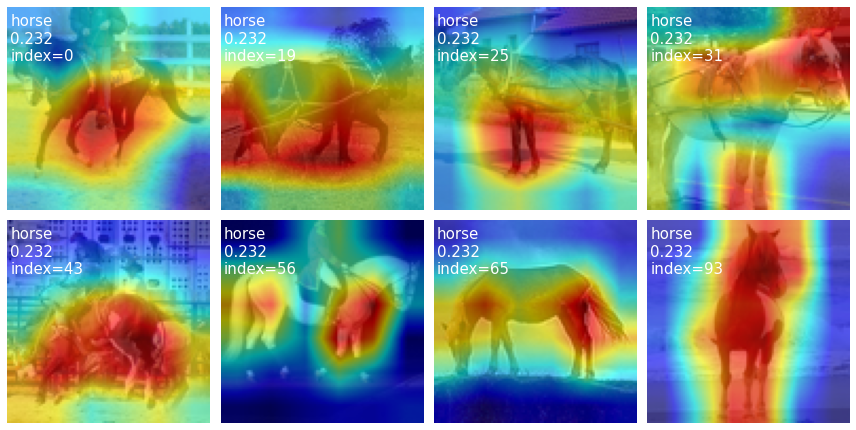

In [1113]:
plot_first_n(test_data_dir, 'horse', alexnet, alexnet_weight)

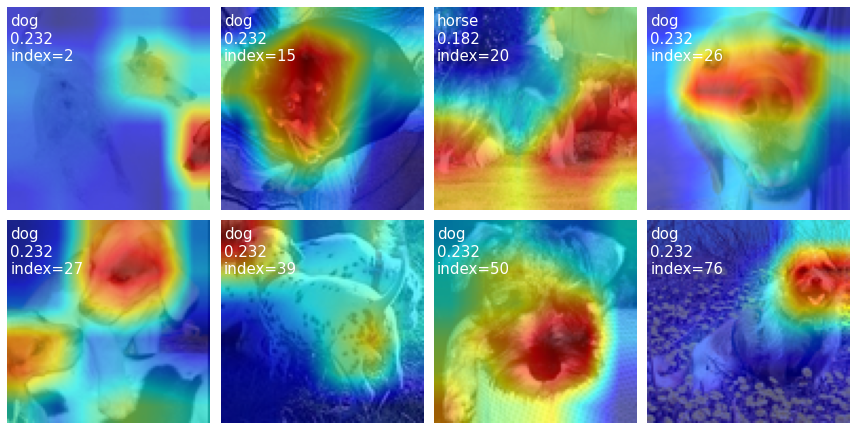

In [1114]:
plot_first_n(test_data_dir, 'dog', alexnet, alexnet_weight)

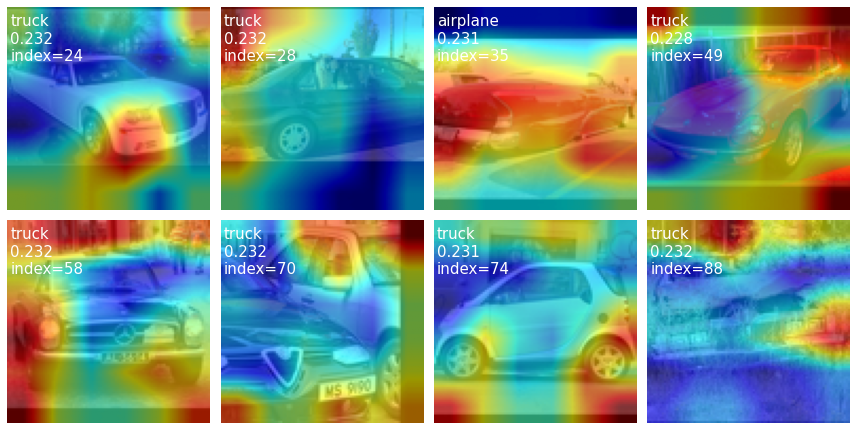

In [1115]:
plot_first_n(test_data_dir, 'car', alexnet, alexnet_weight)

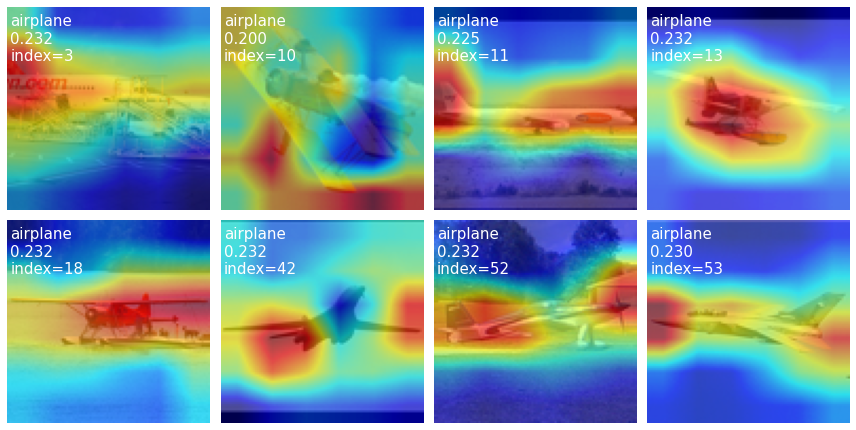

In [1116]:
plot_first_n(test_data_dir, 'airplane', alexnet, alexnet_weight)

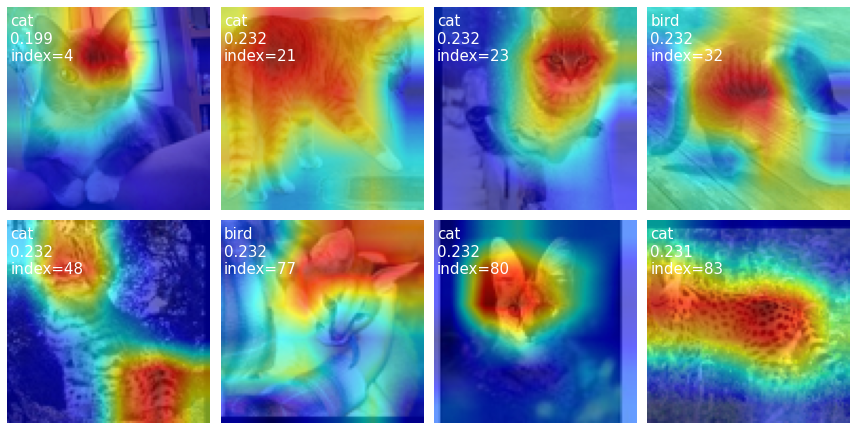

In [1117]:
plot_first_n(test_data_dir, 'cat', alexnet, alexnet_weight)

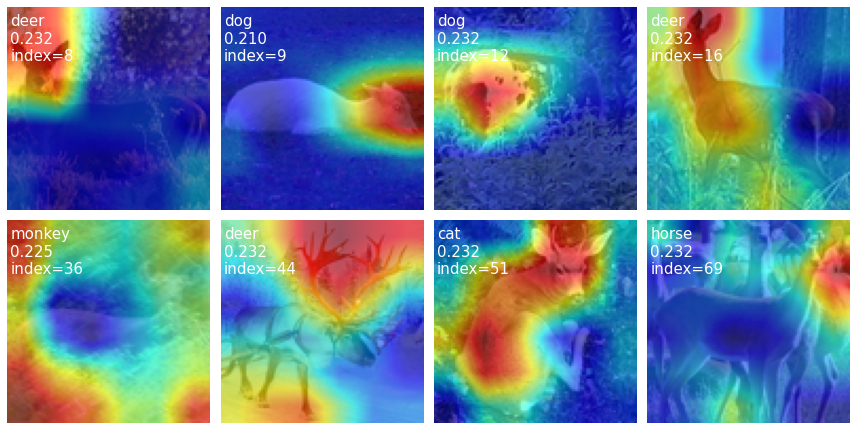

In [1118]:
plot_first_n(test_data_dir, 'deer', alexnet, alexnet_weight)

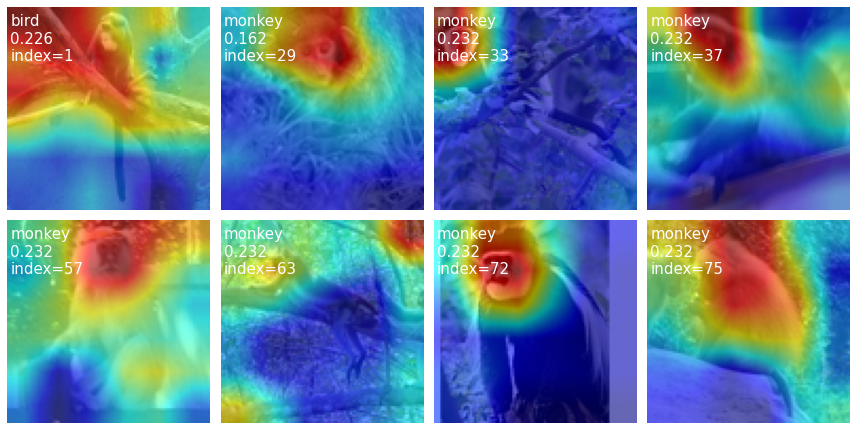

In [1119]:
plot_first_n(test_data_dir, 'monkey', alexnet, alexnet_weight)

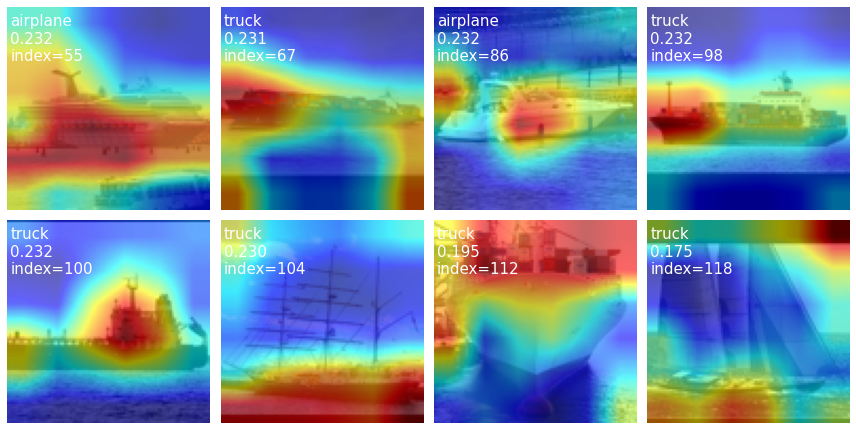

In [1120]:
plot_first_n(test_data_dir, 'ship', alexnet, alexnet_weight)

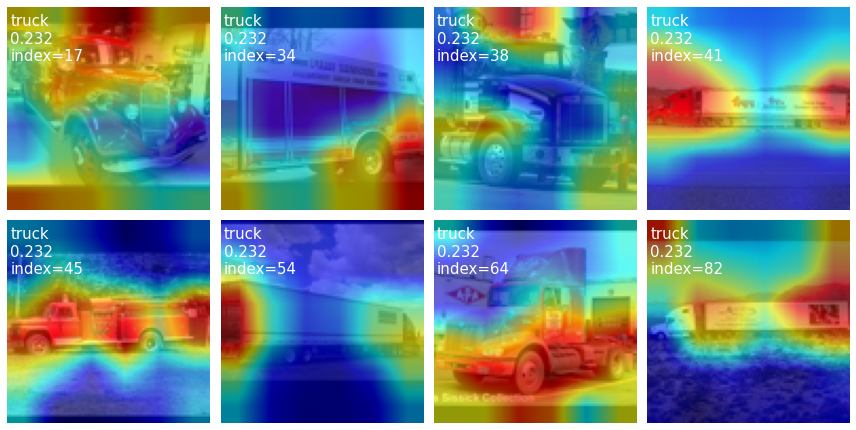

In [1121]:
plot_first_n(test_data_dir, 'truck', alexnet, alexnet_weight)

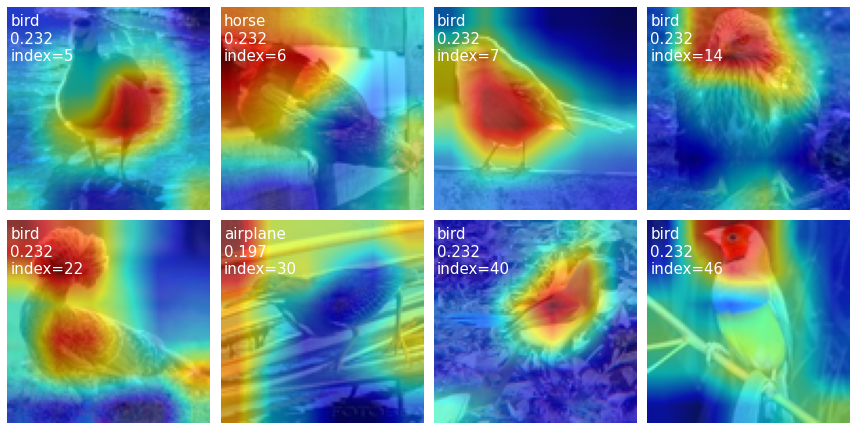

In [1122]:
plot_first_n(test_data_dir, 'bird', alexnet, alexnet_weight)

AlexNet достаточно простая сеть и поэтому допускает много ошибок при классификации.

### Топ 3 категории

Для нескольких изображений, на которых AlexNet допустила ошибку, рассмотрим тепловые карты для топ 3 категорий.

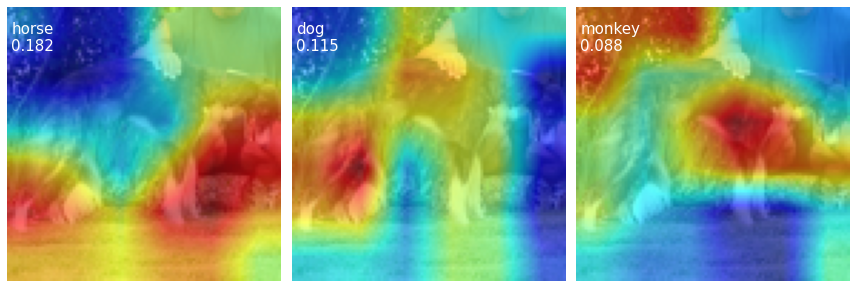

In [1126]:
img = test_data_dir[20][0]
plot_top_k(img, alexnet, alexnet_weight, 3)

На данной фотографии сеть не смогла распознать очертания собаки настолько хорошо насколько распознала в ее лапах копыта лошади

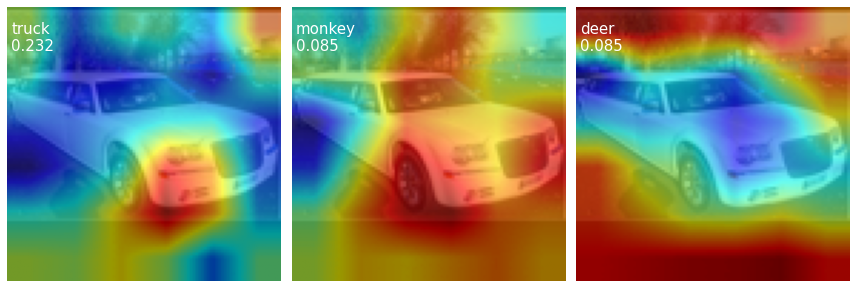

In [1127]:
img = test_data_dir[24][0]
plot_top_k(img, alexnet, alexnet_weight, 3)

На данном изображении можно видеть, что в класс "машина" не попала даже в топ 3 категорий. Сеть обратила внимание на бампер машины, имеющий прямоугольные очертания и подумала, что это грузовик

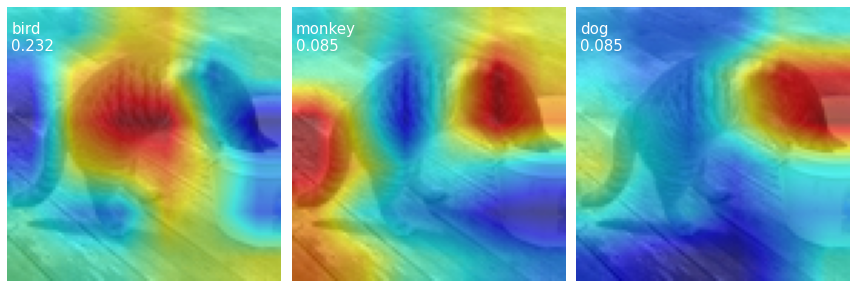

In [1128]:
img = test_data_dir[32][0]
plot_top_k(img, alexnet, alexnet_weight, 3)

Судя по тепловым картам, AlexNet настроилась на морды кошек, поэтому на данной фотографии не смогла определить животное. Туловище кота чем-то напоминает птичье, а хвост поход на обезьянний, поэтому сеть сделала соответствующий выбор.

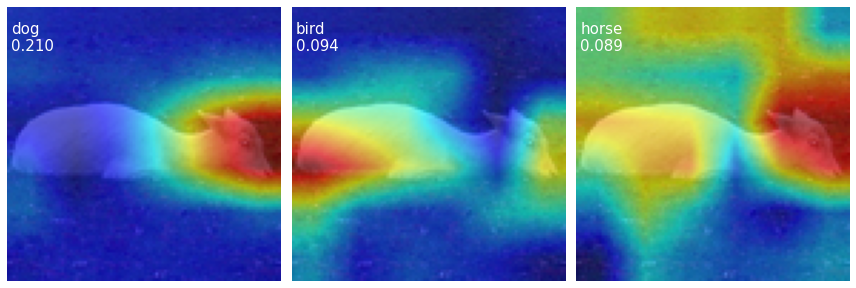

In [1129]:
img = test_data_dir[9][0]
plot_top_k(img, alexnet, alexnet_weight, 3)

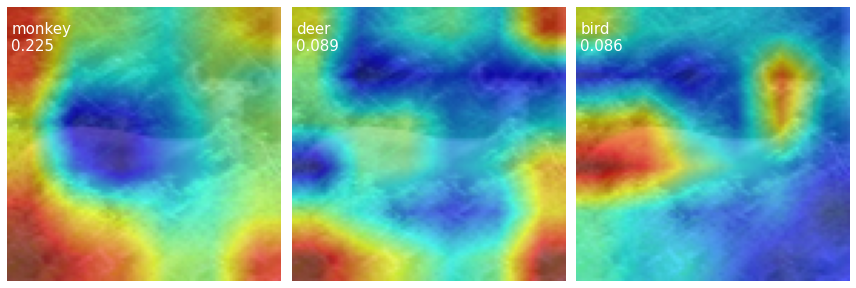

In [1130]:
img = test_data_dir[36][0]
plot_top_k(img, alexnet, alexnet_weight, 3)

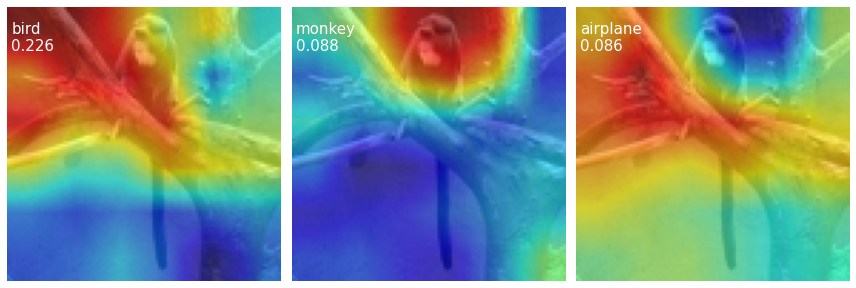

In [1131]:
img = test_data_dir[1][0]
plot_top_k(img, alexnet, alexnet_weight, 3)

На данной фотографии, действительно сложно понять птица это или обезъяна. Голова мартышки сильно напоминает птичий клюв.

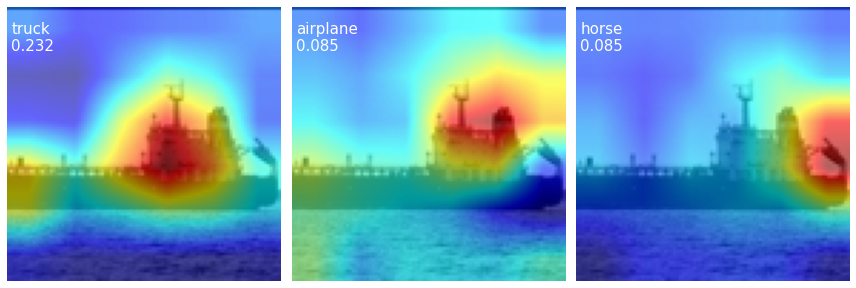

In [1132]:
img = test_data_dir[100][0]
plot_top_k(img, alexnet, alexnet_weight, 3)

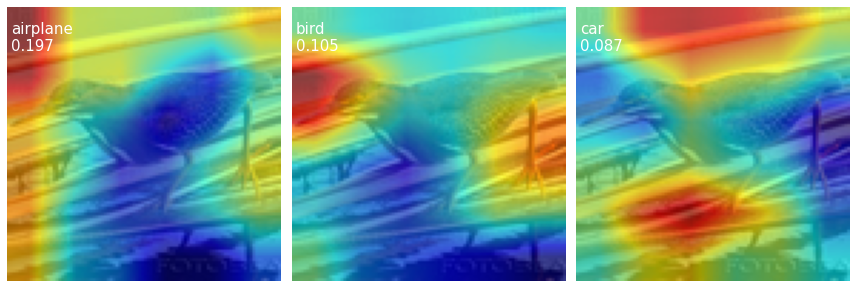

In [1133]:
img = test_data_dir[30][0]
plot_top_k(img, alexnet, alexnet_weight, 3)

На данной фотографии сеть увидела резкие линии веток, напоминающие крылья самолета, поэтому допустила ошибку.

### Влияние аугментаций на тепловые карты

In [1269]:
random_transforms = transforms.Compose([transforms.CenterCrop((64, 64)), transforms.Resize((96, 96)), transforms.RandomVerticalFlip(0.8)])

test_data_transforms = datasets.STL10('.', 'test', transform=random_transforms)

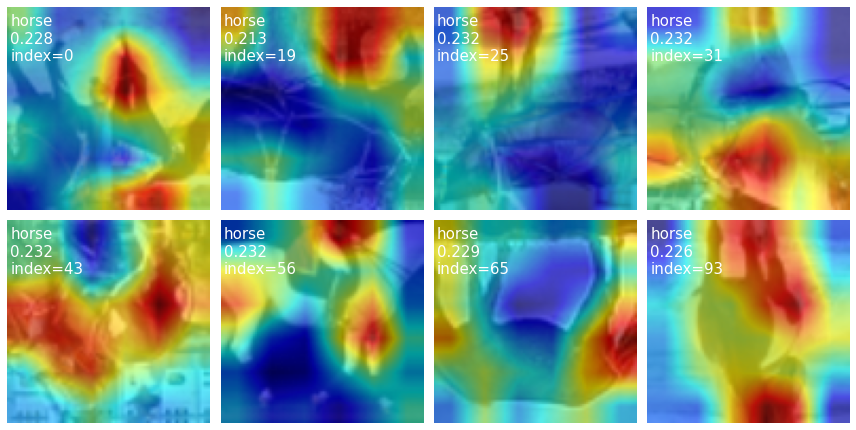

In [1270]:
plot_first_n(test_data_transforms, 'horse', alexnet, alexnet_weight)

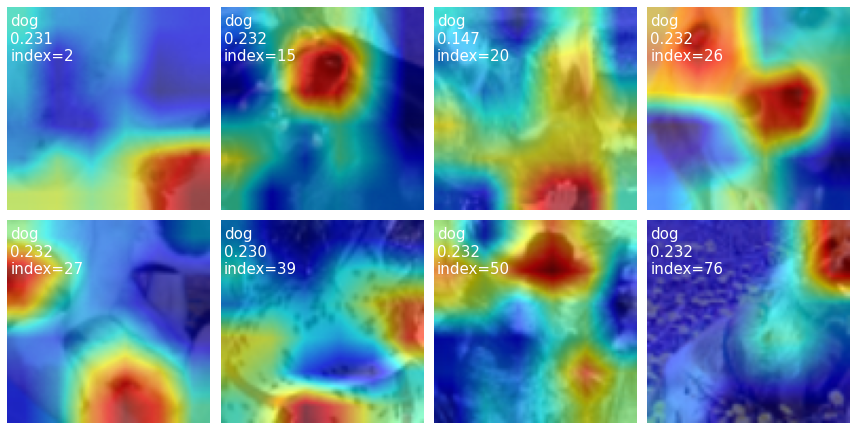

In [1271]:
plot_first_n(test_data_transforms, 'dog', alexnet, alexnet_weight)

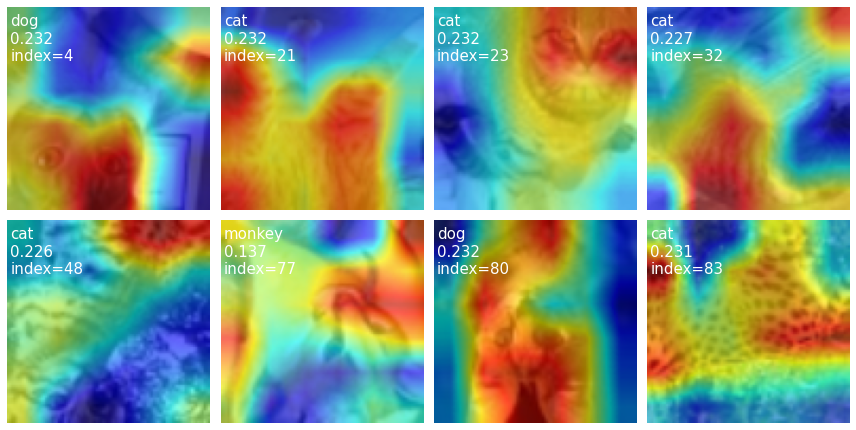

In [1272]:
plot_first_n(test_data_transforms, 'cat', alexnet, alexnet_weight)

В целом модель продолжает улавливать паттерны, но, конечно, качество немного ухудшилось.

## Примеры тепловых карт VGG16

Проделаем тоже самое для VGG16

### Тепловые карты первых 8 изображений определнного класса

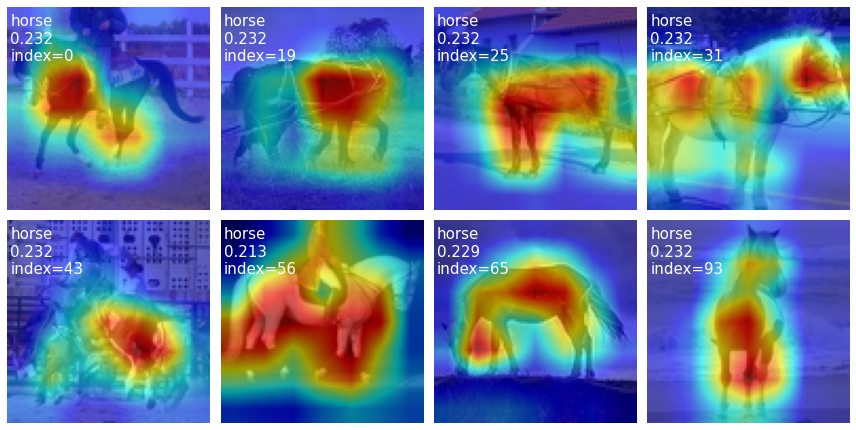

In [525]:
plot_first_n(test_data_dir, 'horse', vgg, vgg_weight)

Сразу можно заметить, что тепловые карты VGG16 намного более точные чем у AlexNet

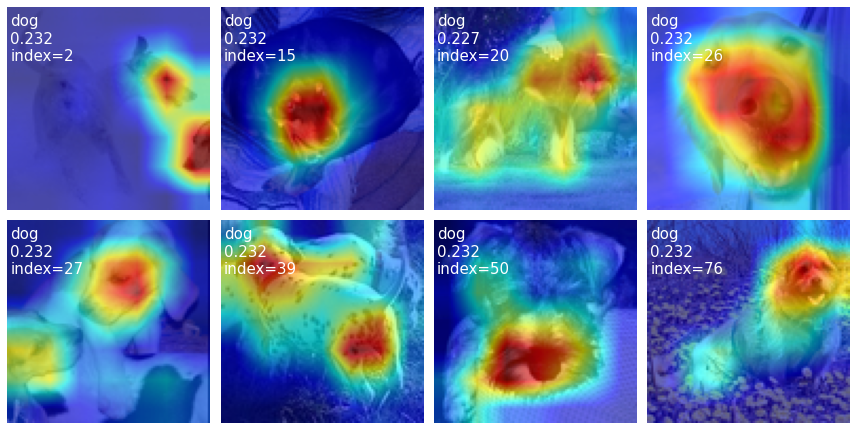

In [526]:
plot_first_n(test_data_dir, 'dog', vgg, vgg_weight)

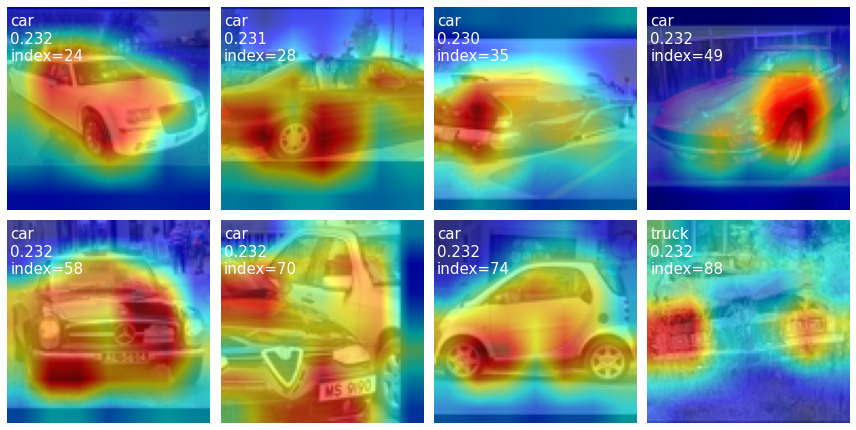

In [527]:
plot_first_n(test_data_dir, 'car', vgg, vgg_weight)

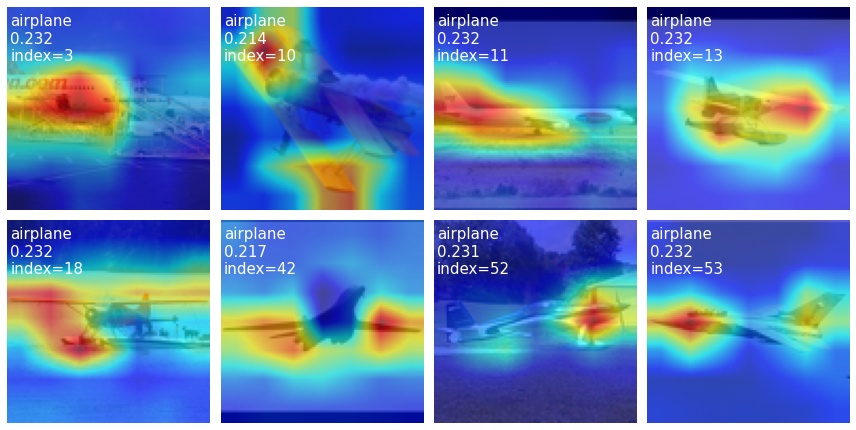

In [528]:
plot_first_n(test_data_dir, 'airplane', vgg, vgg_weight)

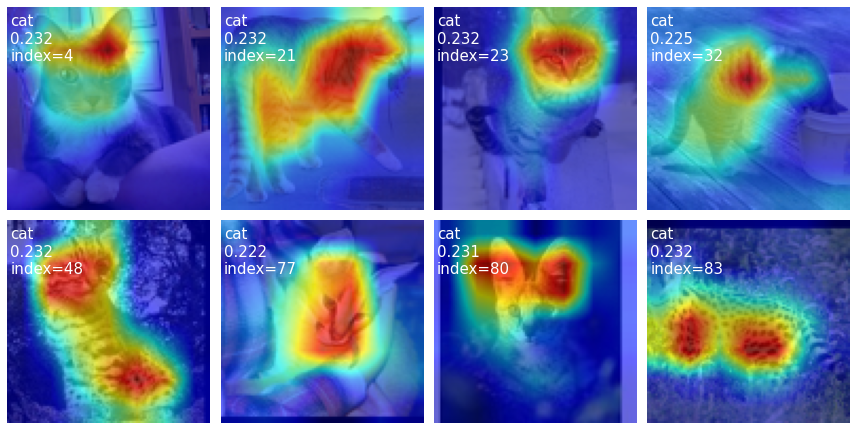

In [529]:
plot_first_n(test_data_dir, 'cat', vgg, vgg_weight)

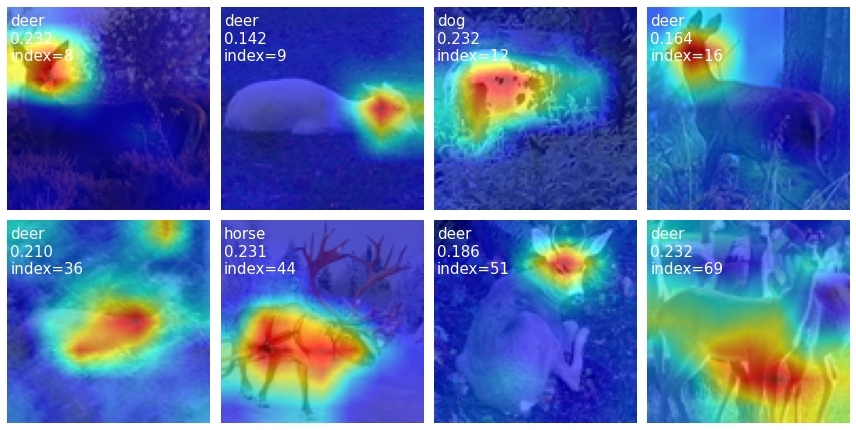

In [530]:
plot_first_n(test_data_dir, 'deer', vgg, vgg_weight)

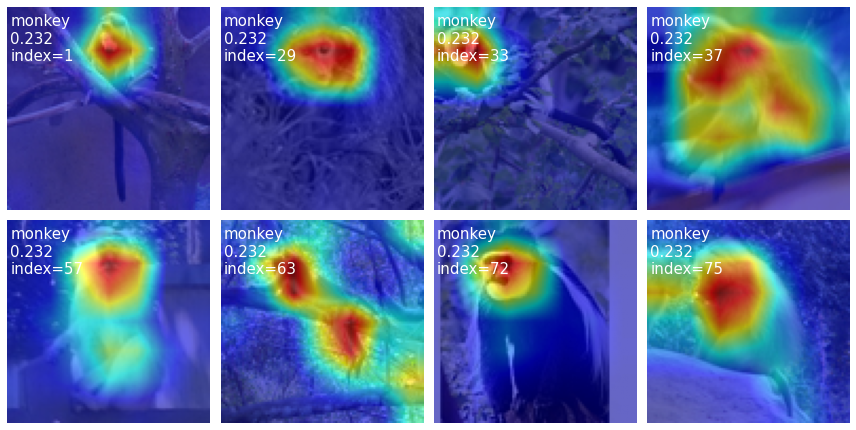

In [531]:
plot_first_n(test_data_dir, 'monkey', vgg, vgg_weight)

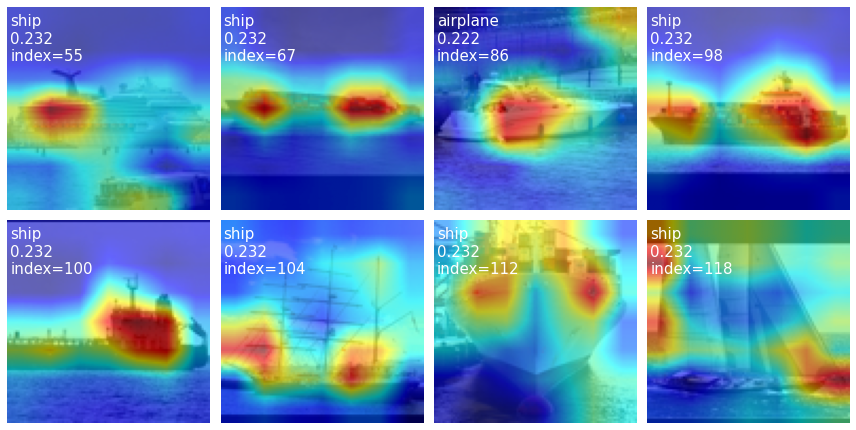

In [532]:
plot_first_n(test_data_dir, 'ship', vgg, vgg_weight)

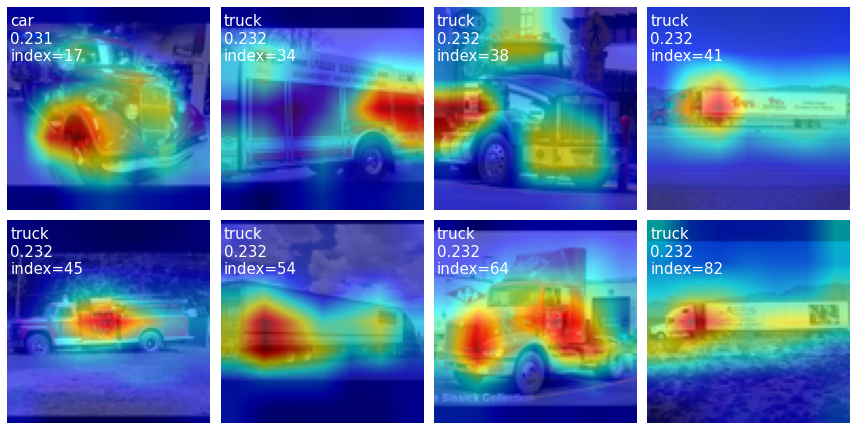

In [533]:
plot_first_n(test_data_dir, 'truck', vgg, vgg_weight)

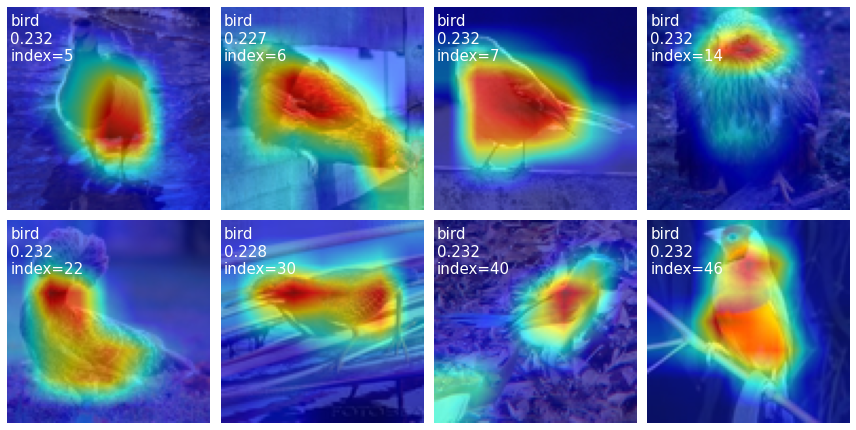

In [644]:
plot_first_n(test_data_dir, 'bird', vgg, vgg_weight)

### Топ 3 категории

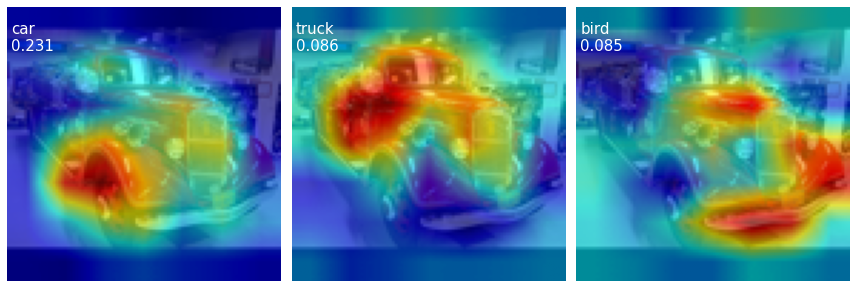

In [538]:
img = test_data_dir[17][0]
plot_top_k(img, vgg, vgg_weight, top_k=3)

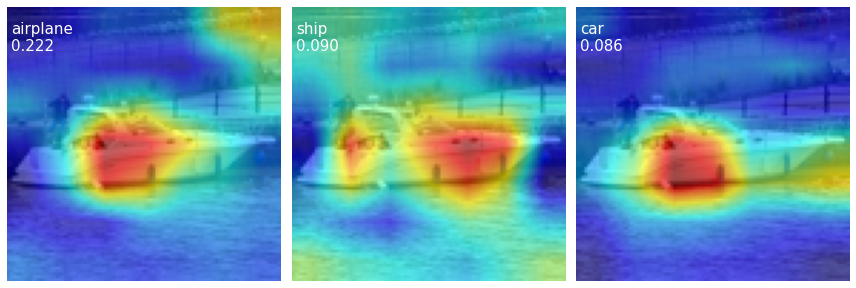

In [539]:
img = test_data_dir[86][0]
plot_top_k(img, vgg, vgg_weight, top_k=3)

Как и случае c AlexNet, сеть распозанала резкие линии корпуса катера, как что-то похожее на крылья самолета

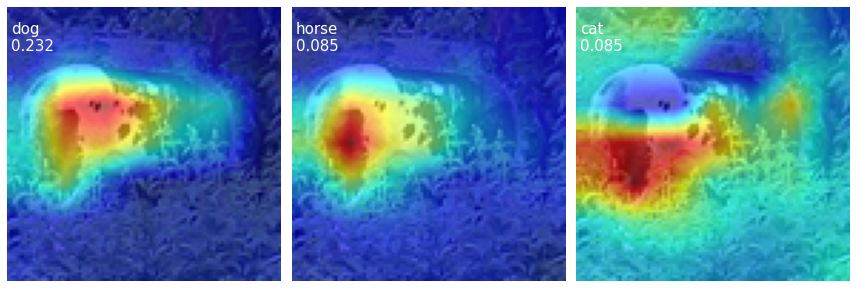

In [540]:
img = test_data_dir[12][0]
plot_top_k(img, vgg, vgg_weight, top_k=3)

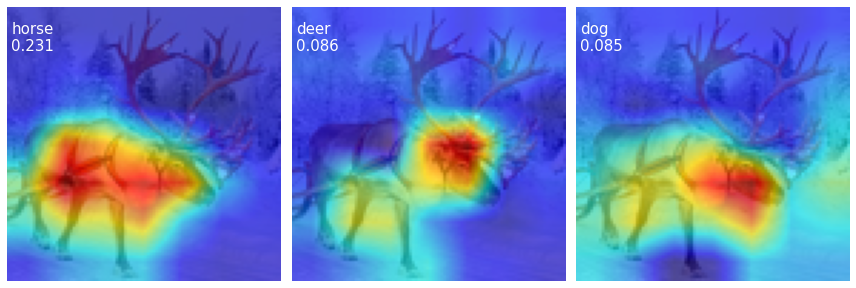

In [541]:
img = test_data_dir[44][0]
plot_top_k(img, vgg, vgg_weight, top_k=3)

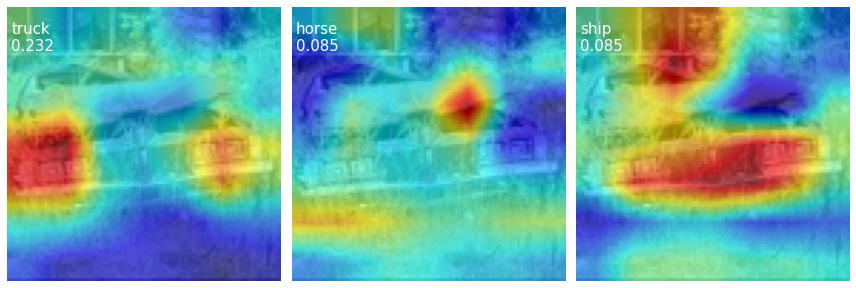

In [542]:
img = test_data_dir[88][0]
plot_top_k(img, vgg, vgg_weight, top_k=3)

По примерам тепловых карт для фотографий машин, можно было заметить, что основным паттерном сигнализирующим о том, что на фотографии машина, являются колеса. На данной же фотографии, колеса не изображены, зато квадратные фары были восприняты моделью как грузовая платформа грузовика 

### Влияние аугментаций на тепловые карты

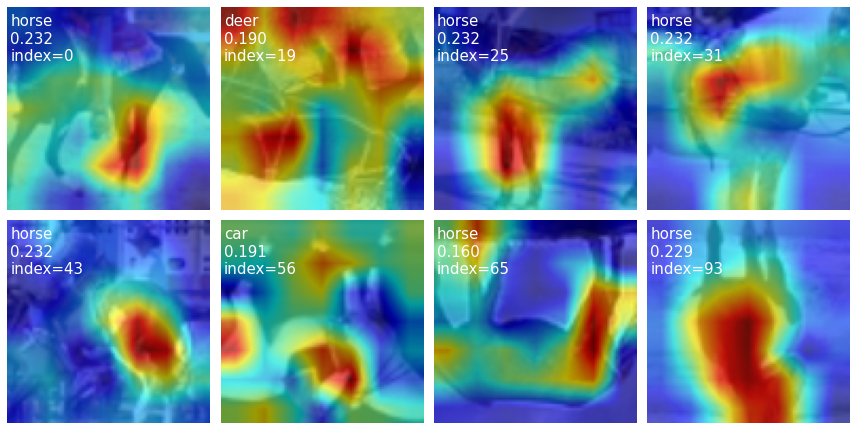

In [1274]:
plot_first_n(test_data_transforms, 'horse', vgg, vgg_weight)

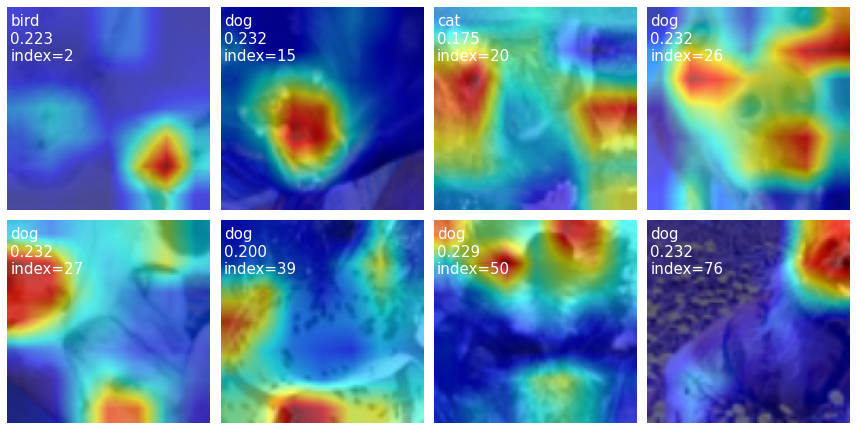

In [1275]:
plot_first_n(test_data_transforms, 'dog', vgg, vgg_weight)

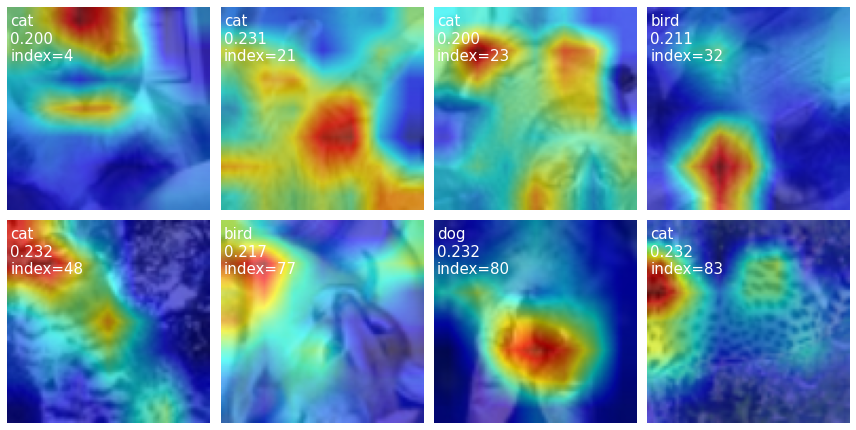

In [1276]:
plot_first_n(test_data_transforms, 'cat', vgg, vgg_weight)

Подведем итоги по CAM.\
Плюсы:
 1. Простота реализации
 2. Наглядная визуализация паттернов, на которые настривается сверточная сеть

Минусы:
 1. CAM применима только к моделям в которых есть Global Average Pooling.
 2. Требуется модифицировать и дообучать модель

# Анализ активаций сверточных слоев во время прямого прохода

Рассмотрим как меняются активации во время прямого прохода по сети. По прежнему рассматриваются AlexNet и VGG16. Чтобы сохранять нужную информацию по время прямого прохода, будем использовать хуки (hooks). На каждом интересующем слое будем сохранять значения активаций.

In [1200]:
vgg = models.vgg16(pretrained=True).to(device)
alexnet = models.alexnet(pretrained=True).to(device)

Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /tmp/xdg_cache/torch/hub/checkpoints/vgg16-397923af.pth


Downloading: "https://download.pytorch.org/models/alexnet-owt-7be5be79.pth" to /tmp/xdg_cache/torch/hub/checkpoints/alexnet-owt-7be5be79.pth


In [1201]:
vgg_relu_inds = [1, 29]
alexnet_relu_inds = [1, 11]

In [1169]:
def get_activations(img_pil, model, relu_inds):
    activations = {}
    X = preprocess(img_pil)
    X = Variable(X.unsqueeze(0)).to(device)
    
    def getActivation(name):
        def hook(model, input, output):
            activations[name] = output.detach()
        return hook
    
    hooks = []
    for i in relu_inds:
        h = model.features[i].register_forward_hook(getActivation('relu'+str(i)))
        hooks.append(h)
    
    out = model(X)
    
    for hook in hooks:
        hook.remove()
    
    return activations

In [1170]:
img = test_data_dir[0][0]
vgg_activations = get_activations(img, vgg, vgg_relu_inds)
alexnet_activations = get_activations(img, alexnet, alexnet_relu_inds)

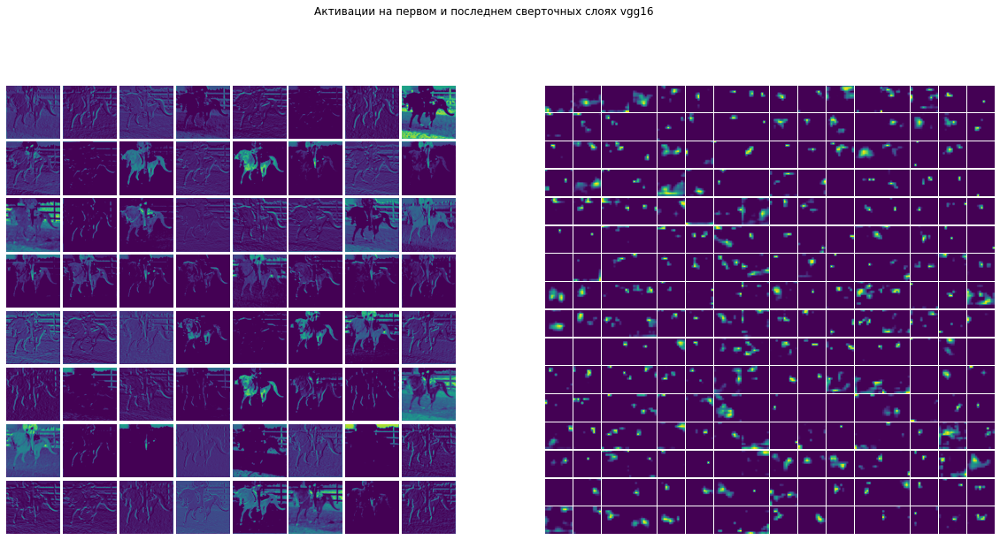

In [1172]:
from mpl_toolkits.axes_grid1 import ImageGrid
relu1 = vgg_activations['relu1']
relu1 = relu1.squeeze().cpu().numpy()
relu2 = vgg_activations['relu29']
relu2 = relu2.squeeze().cpu().numpy()
fig = plt.figure(figsize=(20., 10.))
plt.suptitle('Активации на первом и последнем сверточных слоях vgg16')
grid1 = ImageGrid(fig, 121, 
                 nrows_ncols=(8, 8),
                 axes_pad=0.05,
                 )

grid2 = ImageGrid(fig, 122, 
                 nrows_ncols=(16, 16),
                 axes_pad=0.02,
                 )

for ax, im in zip(grid1, relu1):
    ax.imshow(im)
    ax.axis('off')
    
for ax, im in zip(grid2, relu2):
    ax.imshow(im)
    ax.axis('off')
plt.axis('off')
plt.show()

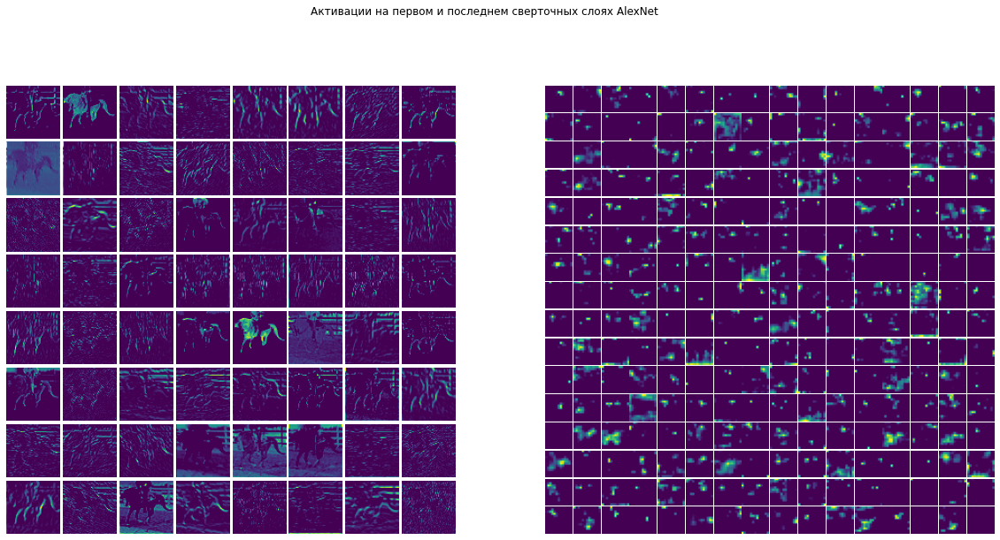

In [1175]:
from mpl_toolkits.axes_grid1 import ImageGrid
relu1 = alexnet_activations['relu1']
relu1 = relu1.squeeze().cpu().numpy()
relu2 = alexnet_activations['relu11']
relu2 = relu2.squeeze().cpu().numpy()
fig = plt.figure(figsize=(20., 10.))
plt.suptitle('Активации на первом и последнем сверточных слоях AlexNet')
grid1 = ImageGrid(fig, 121, 
                 nrows_ncols=(8, 8),
                 axes_pad=0.05,
                 )

grid2 = ImageGrid(fig, 122, 
                 nrows_ncols=(16, 16),
                 axes_pad=0.02,
                 )

for ax, im in zip(grid1, relu1):
    ax.imshow(im)
    ax.axis('off')
    
for ax, im in zip(grid2, relu2):
    ax.imshow(im)
    ax.axis('off')
plt.axis('off')
plt.show()

In [1177]:
img = test_data_dir[86][0]
vgg_activations = get_activations(img, vgg, vgg_relu_inds)
alexnet_activations = get_activations(img, alexnet, alexnet_relu_inds)

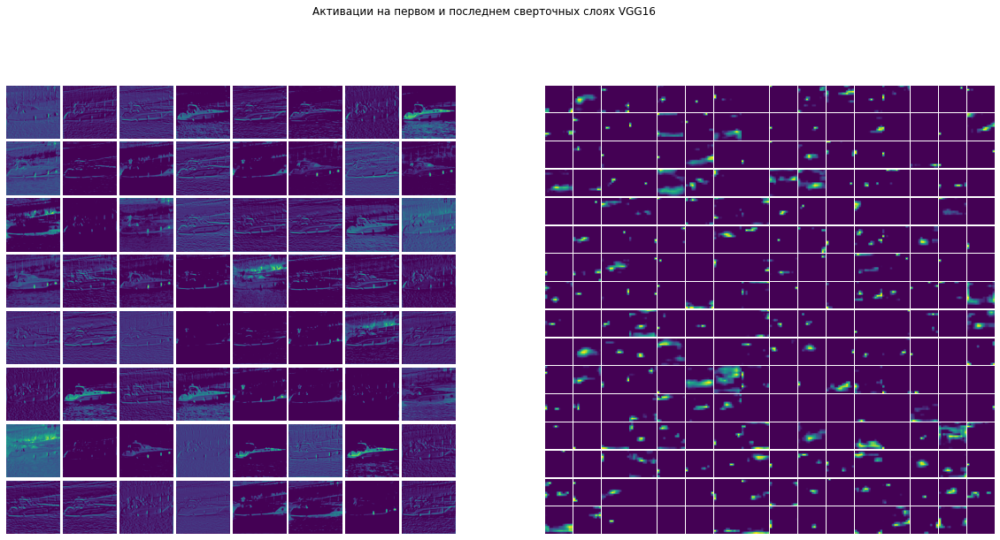

In [1178]:
from mpl_toolkits.axes_grid1 import ImageGrid
relu1 = vgg_activations['relu1']
relu1 = relu1.squeeze().cpu().numpy()
relu2 = vgg_activations['relu29']
relu2 = relu2.squeeze().cpu().numpy()
fig = plt.figure(figsize=(20., 10.))
plt.suptitle('Активации на первом и последнем сверточных слоях VGG16')
grid1 = ImageGrid(fig, 121, 
                 nrows_ncols=(8, 8),
                 axes_pad=0.05,
                 )

grid2 = ImageGrid(fig, 122, 
                 nrows_ncols=(16, 16),
                 axes_pad=0.02,
                 )

for ax, im in zip(grid1, relu1):
    ax.imshow(im)
    ax.axis('off')
    
for ax, im in zip(grid2, relu2):
    ax.imshow(im)
    ax.axis('off')
plt.axis('off')
plt.show()

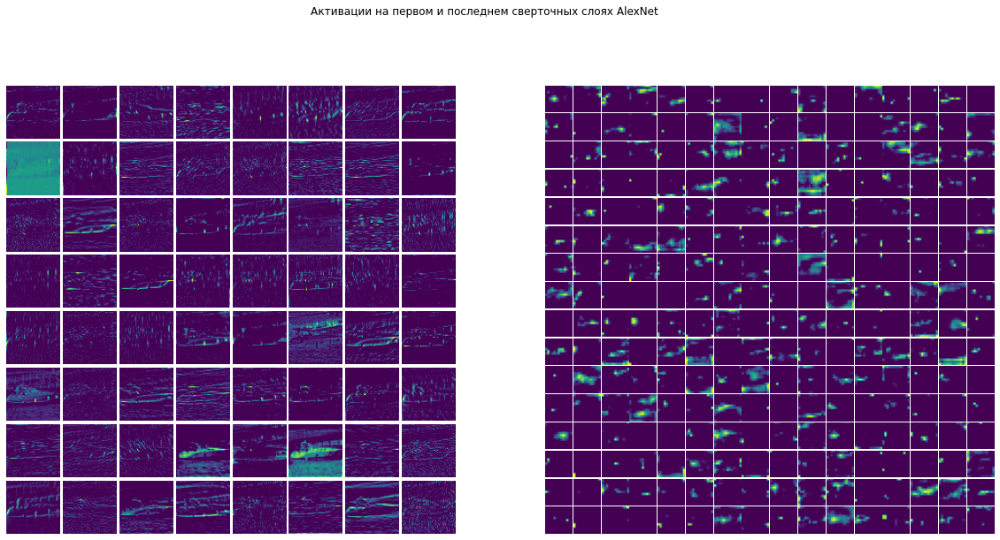

In [1179]:
relu1 = alexnet_activations['relu1']
relu1 = relu1.squeeze().cpu().numpy()
relu2 = alexnet_activations['relu11']
relu2 = relu2.squeeze().cpu().numpy()
fig = plt.figure(figsize=(20., 10.))
plt.suptitle('Активации на первом и последнем сверточных слоях AlexNet')
grid1 = ImageGrid(fig, 121, 
                 nrows_ncols=(8, 8),
                 axes_pad=0.05,
                 )

grid2 = ImageGrid(fig, 122, 
                 nrows_ncols=(16, 16),
                 axes_pad=0.02,
                 )

for ax, im in zip(grid1, relu1):
    ax.imshow(im)
    ax.axis('off')
    
for ax, im in zip(grid2, relu2):
    ax.imshow(im)
    ax.axis('off')
plt.axis('off')
plt.show()

**Итоги:** На первом слое активации хорошо сохраняют очертания изображения. На последнем слое активации становятся более локализованными. В обоих случаях активации достаточно разрежены. Можно наблюдать "мертые фильтры", то есть фильтры, которые полностью занулились.

# Входы максимизирующие активации

Посмотрим какие на каких изображениях тестовой выборки наиболее возбуждаются активации средних слоев. Для этого с помошью хуков будем считать норму интересующего нас тензора во время прямого прохода и сохранять индексы изображений на которых она достигает большого значения. Также, чтобы понять за какие паттерны отвечает фильтр, используем Guided Backpropogation

In [1202]:
class Guided_backprop():
    def __init__(self, model, name_last=None, neuron_idx=None):
        self.model = model
        self.name_last = name_last
        self.neuron_idx = neuron_idx
        self.image_reconstruction = None
        self.activation_maps = []
        self.model.eval()
        self.register_hooks()

    def register_hooks(self):
        def first_layer_hook_fn(module, grad_in, grad_out):
            self.image_reconstruction = grad_in[0]

        def last_layer_hook_fn(module, grad_in, grad_out):
            grad = self.activation_maps.pop()
            # for the forward pass, after the ReLU operation, 
            # if the output value is positive, we set the value to 1,
            # and if the output value is negative, we set it to 0.
            grad[grad > 0] = 1
            
            if self.neuron_idx is not None:
                new = torch.zeros(grad.shape, dtype=torch.float).squeeze()
                new[self.neuron_idx, :] = grad[:, self.neuron_idx, :]
                self.norm = new[self.neuron_idx, :].norm(dim=0)
                new = new.unsqueeze(dim=0)
                grad = new
            return (grad,)

        def forward_hook_fn(module, input, output):
            self.activation_maps.append(output)

        def backward_hook_fn(module, grad_in, grad_out):
            grad = self.activation_maps.pop()
            # for the forward pass, after the ReLU operation, 
            # if the output value is positive, we set the value to 1,
            # and if the output value is negative, we set it to 0.
            grad[grad > 0] = 1 
            
            # grad_out[0] stores the gradients for each feature map,
            # and we only retain the positive gradients
            positive_grad_out = torch.clamp(grad_out[0], min=0.0)
            new_grad_in = positive_grad_out * grad

            return (new_grad_in,)

        modules = list(self.model.features.named_children())

        # travese the modules，register forward hook & backward hook
        # for the ReLU
        self.hooks = []
        for name, module in modules:
            if name == self.name_last:
                hook = module.register_forward_hook(forward_hook_fn)
                self.hooks.append(hook)
                hook = module.register_backward_hook(last_layer_hook_fn)
                self.hooks.append(hook)
                break
            if isinstance(module, nn.ReLU):
                hook = module.register_forward_hook(forward_hook_fn)
                self.hooks.append(hook)
                hook = module.register_backward_hook(backward_hook_fn)
                self.hooks.append(hook)

        # register backward hook for the first conv layer
        first_layer = modules[0][1] 
        first_layer.register_backward_hook(first_layer_hook_fn)

    def visualize(self, input_image, target_class):
        model_output = self.model(input_image)
        self.model.zero_grad()
        pred_class = model_output.argmax().item()
        grad_target_map = torch.zeros(model_output.shape,
                                      dtype=torch.float)
        if target_class is not None:
            grad_target_map[0][target_class] = 1
        else:
            grad_target_map[0][pred_class] = 1
        
        model_output.backward(grad_target_map)
        
        result = self.image_reconstruction.data[0].permute(1,2,0)
        return result.numpy()
    
    def remove_hooks(self):
        for hook in self.hooks:
            hook.remove()

def normalize(image):
    norm = (image - image.mean())/image.std()
    norm = norm * 0.1
    norm = norm + 0.5
    norm = norm.clip(0, 1)
    return norm

In [1204]:
transform = transforms.Compose([
    transforms.Resize(224),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

In [1205]:
class NeuronMax():
    def __init__(self, model, name_last=None, idxs=None, transforms=None, top_k=1):
        self.model = model
        self.name_last = name_last
        self.top_k = top_k
        self.idxs = idxs if idxs is not None else [1]
        self.top_norms = {i:[] for i in idxs}
        self.neuron_idx = neuron_idx
        self.transforms = transforms
        self.image_reconstruction = None
        self.activation_maps = []
        self.model.eval()
        self.register_hooks()

    def register_hooks(self):

        def forward_hook_fn(module, input, output):
            self.norms = output.squeeze().norm(dim=(-2,-1))

        modules = list(self.model.features.named_children())

        # travese the modules，register forward hook
        # for the ReLU
        for name, module in modules:
            if name == self.name_last:
                self.hook = module.register_forward_hook(forward_hook_fn)

    def forward(self, image, idx):
        with torch.no_grad():
            self.img_idx = idx
            tensor = self.transforms(image).unsqueeze(0).to(device)
            model_output = self.model(tensor)
            for i in self.idxs:
                self.top_norms[i].append([self.norms[i], self.img_idx])
                self.top_norms[i] = sorted(self.top_norms[i], key=lambda val: val[0], reverse=True)[:self.top_k]

**Топ 10 изображений для активаций AlexNet**

In [1228]:
name_last = '7'
idx_lst = [10, 100, 200, 300]
model = alexnet
model.to(device)
nm = NeuronMax(model, name_last, idx_lst, transform, 10)
for i, (image, target) in enumerate(tqdm(test_data_dir, desc='img')):
    nm.forward(image, i)

nm.hook.remove()

img: 100%|██████████| 8000/8000 [00:37<00:00, 211.76it/s]


In [ ]:
img_idxs = []
for key, val in nm.top_norms.items():
    for pair in val:
        img_idxs.append(pair[1])

In [1230]:
backprop_imgs = []
model.to('cpu')
for key, val in tqdm(nm.top_norms.items(), desc='filter'):
    for norm, idx in val:
        image = test_data_dir[idx][0]
        tensor = transform(image).unsqueeze(0)
        tensor.requires_grad_()
        guided_bp = Guided_backprop(model, name_last, key)
        result = guided_bp.visualize(tensor, None)
        guided_bp.remove_hooks()
        backprop_imgs.append(result)

filter: 100%|██████████| 4/4 [00:04<00:00,  1.08s/it]


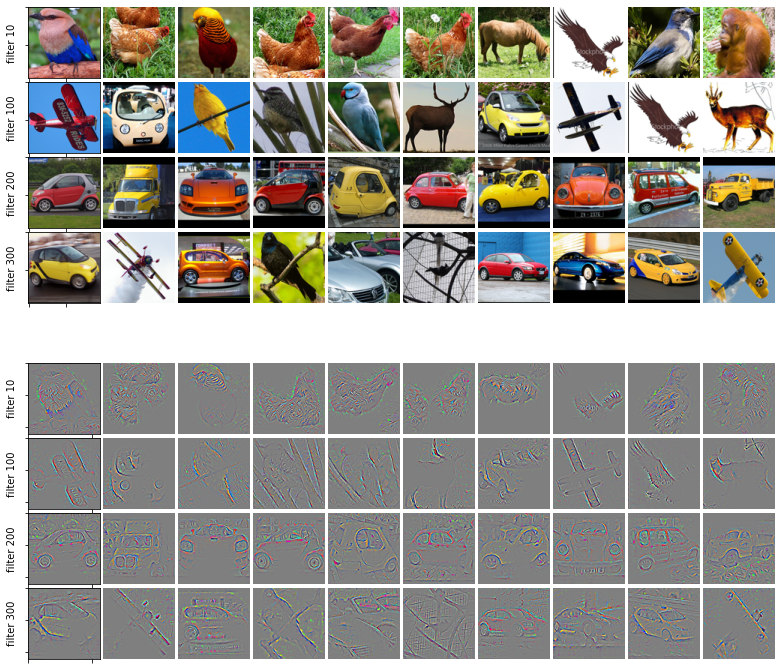

In [1231]:
fig = plt.figure(figsize=(20., 12.))
grid1 = ImageGrid(fig, 211, 
                 nrows_ncols=(4, 10),
                 axes_pad=0.05,
                 )

grid2 = ImageGrid(fig, 212, 
                 nrows_ncols=(4, 10),
                 axes_pad=0.05,
                 )

for i, (ax, idx) in enumerate(zip(grid1, img_idxs)):
    ax.imshow(test_data_dir[idx][0])
    if i % 10 == 0:
        ax.set_ylabel('filter ' + str(idx_lst[i//10]))
        ax.axes.xaxis.set_ticklabels([])
        ax.axes.yaxis.set_ticklabels([])
    else:
        ax.axis('off')


for i, (ax, img) in enumerate(zip(grid2, backprop_imgs)):
    ax.imshow(normalize(img))
    if i % 10 == 0:
        ax.set_ylabel('filter ' + str(idx_lst[i//10]))
        ax.axes.xaxis.set_ticklabels([])
        ax.axes.yaxis.set_ticklabels([])
    else:
        ax.axis('off')

plt.axis('off')
plt.show()

Можно видеть, что каждый фильтр отвечает какому-то паттерну. Например, фильтр 10 по всей видимости отвечает за волнообразные кривые, фильтр 100 за прямые линии.

****Топ 10 изображений для активаций VGG16**

In [1206]:
name_last = '18'
idx_lst = [100, 200, 300, 500]
model = vgg
model.to(device)
nm = NeuronMax(model, name_last, idx_lst, transform, 10)
for i, (image, target) in enumerate(tqdm(test_data_dir, desc='img')):
    nm.forward(image, i)

nm.hook.remove()

img: 100%|██████████| 8000/8000 [00:49<00:00, 160.49it/s]


In [1229]:
img_idxs = []
for key, val in nm.top_norms.items():
    for pair in val:
        img_idxs.append(pair[1])

In [1225]:
backprop_imgs = []
model.to('cpu')
for key, val in tqdm(nm.top_norms.items(), desc='filter'):
    for norm, idx in val:
        image = test_data_dir[idx][0]
        tensor = transform(image).unsqueeze(0)
        tensor.requires_grad_()
        guided_bp = Guided_backprop(model, name_last, key)
        result = guided_bp.visualize(tensor, None)
        guided_bp.remove_hooks()
        backprop_imgs.append(result)

filter: 100%|██████████| 4/4 [00:20<00:00,  5.12s/it]


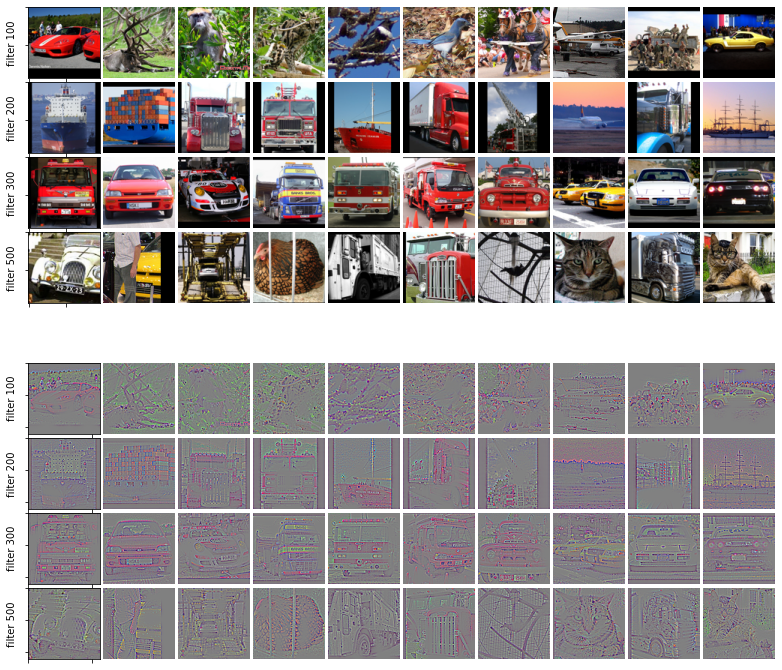

In [1226]:
fig = plt.figure(figsize=(20., 12.))
grid1 = ImageGrid(fig, 211, 
                 nrows_ncols=(4, 10),
                 axes_pad=0.05,
                 )

grid2 = ImageGrid(fig, 212, 
                 nrows_ncols=(4, 10),
                 axes_pad=0.05,
                 )

for i, (ax, idx) in enumerate(zip(grid1, img_idxs)):
    ax.imshow(test_data_dir[idx][0])
    if i % 10 == 0:
        ax.set_ylabel('filter ' + str(idx_lst[i//10]))
        ax.axes.xaxis.set_ticklabels([])
        ax.axes.yaxis.set_ticklabels([])
    else:
        ax.axis('off')


for i, (ax, img) in enumerate(zip(grid2, backprop_imgs)):
    ax.imshow(normalize(img))
    if i % 10 == 0:
        ax.set_ylabel('filter ' + str(idx_lst[i//10]))
        ax.axes.xaxis.set_ticklabels([])
        ax.axes.yaxis.set_ticklabels([])
    else:
        ax.axis('off')

plt.axis('off')
plt.show()

Аналогичная картина. В случае VGG16 даже проще сказать, за что отвечают фильтры. Например, фильтр 100, судя по всему, отвечает за пятнообразные объекты (по типу листьев), фильтр 200 видимо отвечает за клеточный паттерн.

**Итоги:** Guided Backpropogation отличный инструмент для исследования того, что активирует тот или иной нейрон. Найдя изображение на котором активации достигают наибольшего значения, используя Guided Backpropogation можно понять за какие паттерны отвечает нейрон.